# Downsample block tests

This notebook is for test different internal structures for a downsample layer in an U-net. The goal is to adjust the network input (the single embedding vector of an embedding layer) and the network weights to match the output of the network to a target feature map.

In [1]:
import tensorflow as tf
import os
import logging
logging.getLogger("tensorflow").setLevel(logging.ERROR)
tf.autograph.set_verbosity(0)
import time
from matplotlib import pyplot as plt
from matplotlib.image import imread
from IPython import display
import numpy as np
from PIL import Image, ImageDraw
import glob
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
#tf.compat.v1.disable_eager_execution()

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 8297227747782824140
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 4986830848
locality {
  bus_id: 1
  links {
  }
}
incarnation: 722139415789348832
physical_device_desc: "device: 0, name: NVIDIA GeForce GTX 1660 Ti, pci bus id: 0000:01:00.0, compute capability: 7.5"
]


## Enable saving to Google Drive if working with colab, to external SSD, or disable if saving locally

In [2]:
def save_to(save = "locally"):
  if save == "colab":
    from google.colab import drive
    drive.mount('/content/drive')
    %cd drive/MyDrive/Colab Notebooks/drones
  elif save == "ssd":
    os.chdir("D:/GanNoMask")

save_to("ssd")

In [3]:
def load(image_file):
  image = tf.io.read_file(image_file)
  image = tf.io.decode_png(image)
  w = tf.shape(image)[1]
  real_image = image[:, :w, :]
  real_image = tf.cast(real_image, tf.float32)
  return real_image

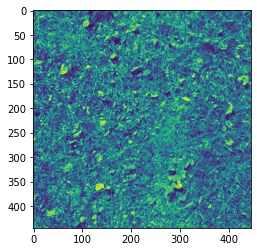

In [4]:
re = load("testtarget.png") / 255
plt.figure()
plt.imshow(re)

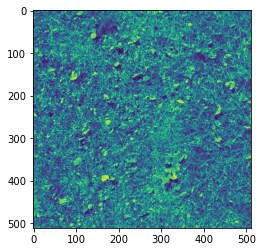

In [5]:
inp = load("testinput.png") / 255
plt.figure()
plt.imshow(inp)

## Constants
Batch size is 1 for these tests, because the goal is to match the network output to a single feature map. Image width and height must be sufficiently large to provide a good statistical sample over the spatial plane. The convolutions will somewhat reduce the network output spatial size due to 'valid' padding. The network is hard-coded to have 1 input channel and 2 output channels.

In [6]:
BATCH_SIZE = 1
IMG_WIDTH = 511
IMG_HEIGHT = 511

## Isotropic low-pass anti-aliasing filter
To ensure that the network operation is not affected by the image axis orientations, and that the network operation is unaffected by sub-pixel shifts, an isotropic anti-aliasing filter is used with horizontal and vertical frequency domain overhead defined by an oversampling factor.

See: https://dsp.stackexchange.com/questions/58301/2-d-circularly-symmetric-low-pass-filter for the filter kernel calculation and https://dsp.stackexchange.com/questions/58226/auto-detection-of-rotation-angle-on-arbitrary-image-with-orthogonal-features/58287#58287 for the window function calculation.


In [7]:
oversampling = 2  # Oversampling factor, 2 is a good choice
kernelN = 9  # Horizontal size of the kernel, also its vertical size. Must be odd. 9 is a good choice when oversampling == 2.

from scipy import special

def circularLowpassKernel(omega_c, N):  # omega = cutoff frequency in radians (pi is max), N = horizontal size of the kernel, also its vertical size, must be odd.
  kernel = np.fromfunction(lambda x, y: omega_c*special.j1(omega_c*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2))/(2*np.pi*np.sqrt((x - (N - 1)/2)**2 + (y - (N - 1)/2)**2)), [N, N])
  kernel[(N - 1)//2, (N - 1)//2] = omega_c**2/(4*np.pi)
  return kernel 

def rotatedCosineWindow(N):  # N = horizontal size of the targeted kernel, also its vertical size, must be odd.
  return np.fromfunction(lambda y, x: np.maximum(np.cos(np.pi/2*np.sqrt(((x - (N - 1)/2)/((N - 1)/2 + 1))**2 + ((y - (N - 1)/2)/((N - 1)/2 + 1))**2)), 0), [N, N])

window = rotatedCosineWindow(kernelN)

kernel_cutoff_pi = circularLowpassKernel(np.pi/oversampling, kernelN)
kernel_cutoff_minipi = circularLowpassKernel(0.95 * np.pi/oversampling, kernelN)

windowedkernel_cutoff_minipi = kernel_cutoff_minipi*window
windowedkernel_cutoff_minipi /= np.sum(windowedkernel_cutoff_minipi, axis=(0, 1)) # Normalize to sum = 1
windowedkernel_cutoff_minipi = windowedkernel_cutoff_minipi.astype(np.float32)


windowedkernel_cutoff_pi = kernel_cutoff_pi*window
windowedkernel_cutoff_pi /= np.sum(windowedkernel_cutoff_pi, axis=(0, 1)) # Normalize to sum = 1
windowedkernel_cutoff_pi = windowedkernel_cutoff_pi.astype(np.float32)

#Divide by zero warnings are OK

C:\ProgramData\Miniconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in true_divide
  import sys


In [8]:
expansion_kernel = np.array([[0, 0, 0], [0, 1, 0], [0, 0, 0]]).astype("float32")

Plot the anti-aliasing filter kernel and frequency response:

Kernel:


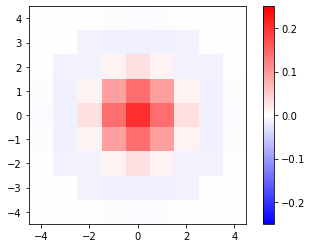

Frequency response:


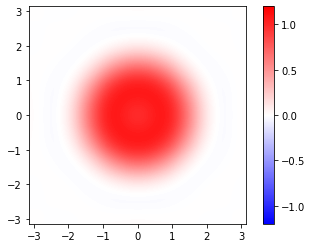

Kernel:


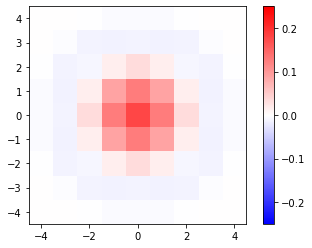

Frequency response:


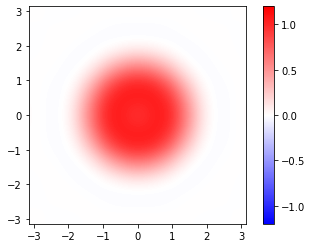

In [9]:
print("Kernel:")
plt.imshow(windowedkernel_cutoff_pi, vmin=-0.25, vmax=0.25, cmap='bwr', extent=[-kernelN/2, kernelN/2, -kernelN/2, kernelN/2])
plt.colorbar()
plt.show()

print("Frequency response:")
freq_resp = np.real(np.fft.fftshift(np.fft.fft2(np.roll(np.pad(windowedkernel_cutoff_pi, 100, mode = 'constant', constant_values = 0), shift = (-kernelN//2-99, -kernelN//2-99), axis = (0, 1)))))
plt.imshow(freq_resp, vmin=-1.2, vmax=1.2, cmap='bwr', extent=[-np.pi, np.pi, -np.pi, np.pi])
plt.colorbar()
plt.show()

print("Kernel:")
plt.imshow(windowedkernel_cutoff_minipi, vmin=-0.25, vmax=0.25, cmap='bwr', extent=[-kernelN/2, kernelN/2, -kernelN/2, kernelN/2])
plt.colorbar()
plt.show()

print("Frequency response:")
freq_resp = np.real(np.fft.fftshift(np.fft.fft2(np.roll(np.pad(windowedkernel_cutoff_minipi, 100, mode = 'constant', constant_values = 0), shift = (-kernelN//2-99, -kernelN//2-99), axis = (0, 1)))))
plt.imshow(freq_resp, vmin=-1.2, vmax=1.2, cmap='bwr', extent=[-np.pi, np.pi, -np.pi, np.pi])
plt.colorbar()
plt.show()

#plt.plot(freq_resp[100])

# Network definition and network and target noise initialization

Initialize the network input, the network structure, the network, and target noise which is white noise with frequency-domain overhead as dictated by the oversampling factor (defined earlier):

tf.Tensor(
[[[0.21568628]
  [0.47843137]
  [0.41568628]
  ...
  [0.4117647 ]
  [0.5294118 ]
  [0.42352942]]

 [[0.5529412 ]
  [0.28235295]
  [0.4862745 ]
  ...
  [0.3764706 ]
  [0.5411765 ]
  [0.3764706 ]]

 [[0.73333335]
  [0.50980395]
  [0.44313726]
  ...
  [0.34117648]
  [0.22745098]
  [0.3137255 ]]

 ...

 [[0.39607844]
  [0.35686275]
  [0.7176471 ]
  ...
  [0.21960784]
  [0.21960784]
  [0.23529412]]

 [[0.3137255 ]
  [0.4117647 ]
  [0.5529412 ]
  ...
  [0.0627451 ]
  [0.0627451 ]
  [0.05098039]]

 [[0.56078434]
  [0.7254902 ]
  [0.654902  ]
  ...
  [0.39215687]
  [0.30980393]
  [0.28627452]]], shape=(511, 511, 1), dtype=float32)


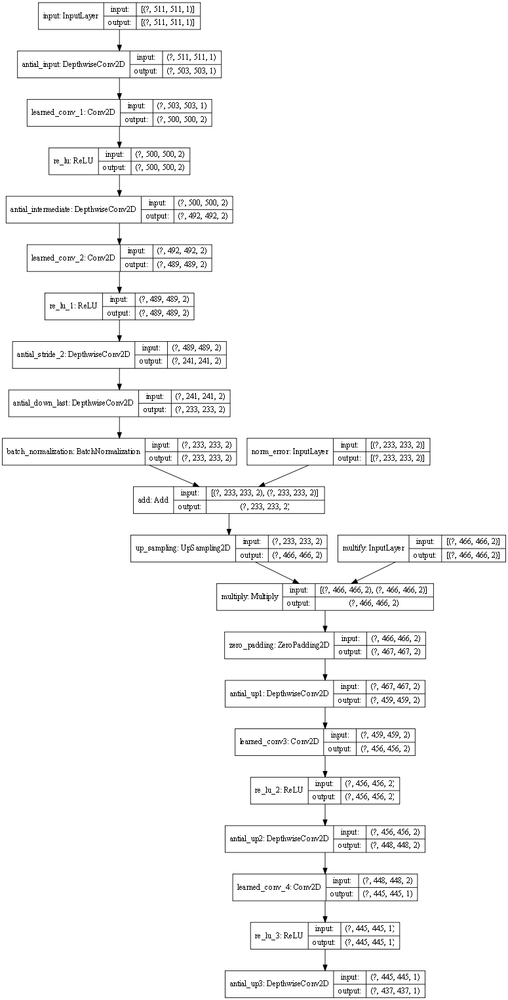

In [10]:
# Initialize an anti-aliasing layer
def init_antial(layer, kernel, expansion = False):
  reps = np.shape(layer.get_weights())[3]
  new_w = tf.repeat(tf.constant([[kernel]]), reps, axis = 3)
  new_w = tf.reshape(new_w, [kernel.shape[0], kernel.shape[1], reps, 1])
  if expansion:
    new_w = tf.repeat(tf.constant([[kernel]]), 4, axis = 3)
    new_w = tf.reshape(new_w, [3, 3, 2, 2])
  layer.set_weights([new_w])
  layer.trainable = False
  
# Define the multiplication layer for the unet
def multiply_layer():
  two_row_root = tf.constant([[0, 0], [0, 4]])
  almost_shape = tf.tile(two_row_root, [233, 233])
  shape = tf.repeat(tf.expand_dims(almost_shape, axis = -1), 1, axis = -1)
  shape = tf.cast(shape, "float32")
  shape = tf.expand_dims(shape, axis = 0)
  return shape

multiply_layer = multiply_layer()

def Model():  
  z = tf.keras.Input(shape = (511, 511, 1), name = "input")
  multify = tf.keras.Input(shape = (466, 466, 2), name = "multify")
  error = tf.keras.Input(shape = (233, 233, 2), name = "norm_error")
  
  y = multify

  x = z
  
  noisy = error
  
  initializer = tf.keras.initializers.RandomUniform(-1, 1)

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_input")(x)

  # -------- downsample start ---------

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=initializer, use_bias=True, name = "learned_conv_1")(x)

  x = tf.keras.layers.ReLU()(x)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_intermediate")(x)

  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=initializer, use_bias=True, name = "learned_conv_2")(x)
  # Note that ReLu limits the output to non-negative values, so the target needs to be non-negative with isotropic filtering applied

  x = tf.keras.layers.ReLU()(x)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=2, padding='valid', use_bias=False, name = "antial_stride_2")(x) # First, stride 2 anti-aliasing filter

  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_down_last")(x) # Then, restore frequency-domain overhead

  # -------- downsample ends ---------
  
  # Normalize and add some noise
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.add([x, noisy])
  
  # -------- upsample starts ---------

  # 1. zero stuffing

  x = tf.keras.layers.UpSampling2D(size = (2, 2), name = "up_sampling")(x)
  
  x = tf.keras.layers.multiply([x, y])
  
  x = tf.keras.layers.ZeroPadding2D(padding = ((0, 1), (0, 1)), name = "zero_padding")(x)
  
  # 2. anti-aliasing (change cutoff here to a bit lower here!)
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up1")(x)
  
  # 3. conv2d learned 1, relu
  
  x = tf.keras.layers.Conv2D(2, 4, strides=1, padding='valid', kernel_initializer=initializer, use_bias=True, name = "learned_conv3")(x)
  
  x = tf.keras.layers.ReLU()(x)

  # 4. anti-aliasing
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up2")(x)

  
  # 5. conv2d learned 2, relu
  
  x = tf.keras.layers.Conv2D(1, 4, strides=1, padding='valid', kernel_initializer=initializer, use_bias=True, name = "learned_conv_4")(x)
  
  x = tf.keras.layers.ReLU()(x)

  # 6. anti-aliasing
  
  x = tf.keras.layers.DepthwiseConv2D(windowedkernel_cutoff_pi.shape[0], strides=1, padding='valid', use_bias=False, name = "antial_up3")(x)

  # ---------- upsample ends ----------

  model = tf.keras.Model(inputs=[z, multify, error], outputs=x)

  init_antial(model.get_layer('antial_input'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_intermediate'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_stride_2'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_down_last'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up1'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up2'), windowedkernel_cutoff_pi)
  init_antial(model.get_layer('antial_up3'), windowedkernel_cutoff_pi)  

  return model

model = Model()

def filter_target(noise, kernel):
  reps = tf.shape(noise)[-1]
  channeled_kernel = tf.repeat(kernel, reps)
  noise = tf.nn.depthwise_conv2d(noise, tf.reshape(channeled_kernel, (kernel.shape[0], kernel.shape[1], reps, 1)), [1, 1, 1, 1], padding = "VALID")
  return noise

def random_noise(batch_size, img_width, img_height, channels): ## Some random noise to prevent the model's cheating
    noise_vector = tf.random.uniform([batch_size, img_width, img_height, channels], minval = 1e-6, maxval = 9e-6) # Uniform between 0 and 1
    return noise_vector

# Initialize random noise input
z = inp

error = random_noise(1, 233, 233, 2)

print(z)

z = tf.expand_dims(z, axis = 0)

target = tf.expand_dims(re, axis = 0)

target = filter_target(target, windowedkernel_cutoff_pi)

tf.keras.utils.plot_model(model, show_shapes=True, dpi=64)

## Testing whether the multiplication works as intended

In [11]:
aaa = random_noise(1, 233, 233, 1)
aaa = tf.keras.layers.UpSampling2D(size = (2, 2))(aaa)
aaa = tf.keras.layers.multiply([aaa, multiply_layer])
aaa = tf.keras.layers.ZeroPadding2D(padding = ((0 , 1), (0, 1)))(aaa)
aaa[0]

<tf.Tensor: shape=(467, 467, 1), dtype=float32, numpy=
array([[[0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00],
        ...,
        [0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00]],

       [[0.0000000e+00],
        [2.6613254e-05],
        [0.0000000e+00],
        ...,
        [0.0000000e+00],
        [3.3794462e-05],
        [0.0000000e+00]],

       [[0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00],
        ...,
        [0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00]],

       ...,

       [[0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00],
        ...,
        [0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00]],

       [[0.0000000e+00],
        [5.0865974e-06],
        [0.0000000e+00],
        ...,
        [0.0000000e+00],
        [1.3643390e-05],
        [0.0000000e+00]],

       [[0.0000000e+00],
        [0.0000000e+00],
        [0.0000000e+00],
        ...,
        [0.0000000e

## Define loss and optimizer

L2 loss is used. Adam optimizer is used.

In [12]:
def model_loss(gen_output, target):

  l2_loss = tf.reduce_mean((target - gen_output)**2)

  return l2_loss

def select_optimizer():
  #optimizer = tf.keras.optimizers.Adam(learning_rate=0.01, beta_1=0.5, beta_2=0.99, epsilon=1e-07)
  optimizer = tf.keras.optimizers.Adam()
  return optimizer

optimizer = select_optimizer()

## Image saving, training step, and fit function
Save losses to TensorBoard, show and save network output and show some basic stats every `save_every` epochs. Save trained network when fitting is finished, after `epochs` epochs.

In [13]:
save_every = 100 # How many epochs to skip between data display and saving

def generate_images(model, z, multiply_layer, target, save = False, epoch = 0): # the training parameter is for batchnorm, in case it is used
  error = random_noise(1, 233, 233, 2)
  prediction = model([z, multiply_layer, error], training=False)
  plt.figure(figsize=(10, 10))
  # red = channel 0, green = channel 1, blue = channel 0
  first = prediction[0, ...]
  second = target[0, ...]
  display_list = [first, second]
  title = ['Network output', 'Target']
  
  if save:
    name = str(epoch).zfill(4)
    tf.keras.preprocessing.image.save_img((im_dir + str(name) + ".png"), first)

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()
  
@tf.function
def train_step(z, multiply_layer, target, epoch):
  with tf.GradientTape() as tape:
    error = random_noise(1, 233, 233, 2)
    gen_output = model([z, multiply_layer, error], training=True)
    loss = model_loss(gen_output, target)
    
  gradients = tape.gradient(loss, model.trainable_variables)
  
  optimizer.apply_gradients(zip(gradients, model.trainable_variables))
  
  with summary_writer.as_default():
    tf.summary.scalar('model_loss', loss, step=epoch)

def fit(epochs):
  for epoch in range(epochs + 1):
    
    # Train
    start = time.time()
    if epoch > 0:
      train_step(z, multiply_layer, target, epoch)
    elapsed = time.time() - start
    if epoch % save_every == 0 or epoch == epochs:
      #display.clear_output(wait=True)
      generate_images(model, z, multiply_layer, target, save = True) #training = ?
      if epoch == 0:
        print("Before fitting")
      else:
        print('Training epoch {}, took {} s\n'.format(epoch, elapsed))
      print("Loss: " + str(tf.keras.backend.get_value(model_loss(model([z, multiply_layer, error], training=True), target))))
      print("RMS deviance: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.reduce_mean((target - model([z, multiply_layer, error], training=True))**2)))))
      print("Learned Min: " + str(tf.keras.backend.get_value(tf.math.reduce_min(model.get_layer('learned_conv_1').get_weights()[0]))))
      print("Learned RMS: " + str(tf.keras.backend.get_value(tf.math.sqrt(tf.math.reduce_mean(model.get_layer('learned_conv_1').get_weights()[0]**2)))))
      print("Learned Max: " + str(tf.keras.backend.get_value(tf.math.reduce_max(model.get_layer('learned_conv_1').get_weights()[0]))))
    
  checkpoint.save(file_prefix=checkpoint_prefix)

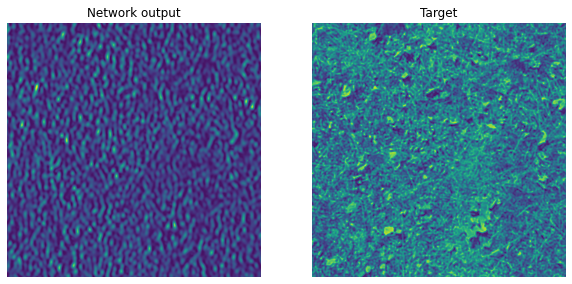

In [14]:
generate_images(model, z, multiply_layer, target)

## Initiate image and log dirs and TensorBoard

In [15]:
checkpoint_dir = './training_checkpoints_downup'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(model=model)
checkpoint.save(file_prefix=checkpoint_prefix)

def checkpoint_save(epoch, inEpochs = 30):
  if (epoch + 1) % inEpochs == 0:
    checkpoint.save(file_prefix=checkpoint_prefix)

import datetime
log_dir = "logs/"
im_dir = "images/fit" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"
os.makedirs(im_dir)
summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [17]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir} --host localhost --port 6276

Reusing TensorBoard on port 6276 (pid 14820), started 0:04:21 ago. (Use '!kill 14820' to kill it.)

## Fit the model

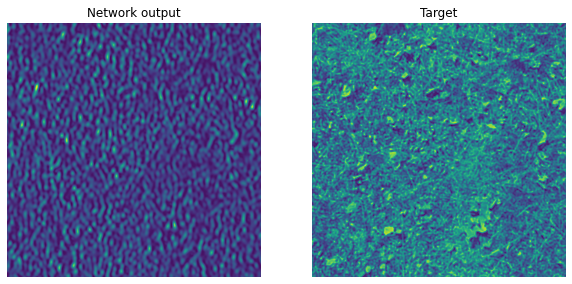

Before fitting
Loss: 28.116726
RMS deviance: 5.3025208
Learned Min: -0.9892893
Learned RMS: 0.5939364
Learned Max: 0.99746275


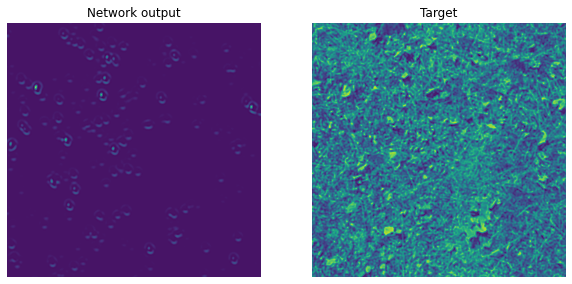

Training epoch 100, took 0.28528308868408203 s

Loss: 0.30153242
RMS deviance: 0.54911965
Learned Min: -0.96982074
Learned RMS: 0.59243923
Learned Max: 0.91316664


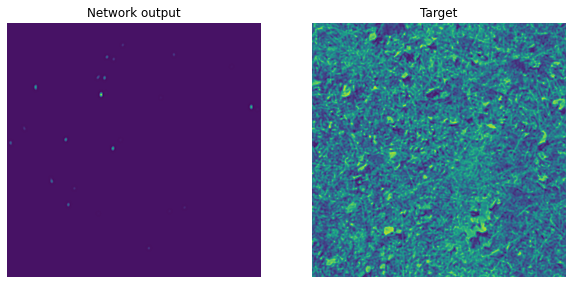

Training epoch 200, took 0.31853342056274414 s

Loss: 0.2100528
RMS deviance: 0.4583152
Learned Min: -0.9751995
Learned RMS: 0.59272623
Learned Max: 0.90097886


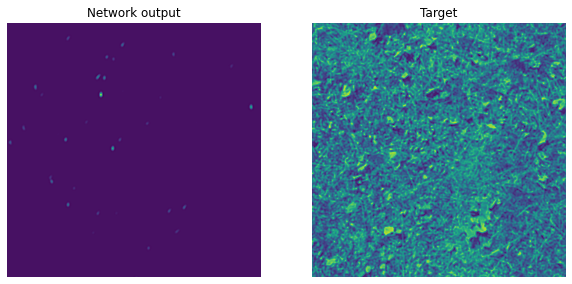

Training epoch 300, took 0.32386231422424316 s

Loss: 0.20488964
RMS deviance: 0.45264736
Learned Min: -0.97359437
Learned RMS: 0.5925801
Learned Max: 0.8972753


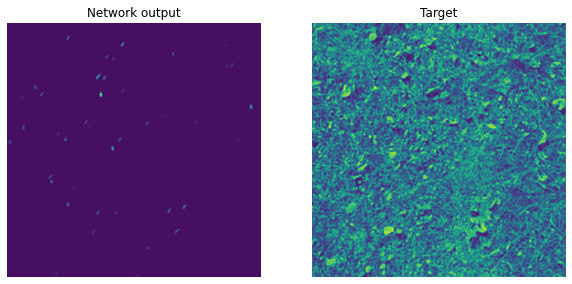

Training epoch 400, took 0.4184696674346924 s

Loss: 0.20306753
RMS deviance: 0.45063016
Learned Min: -0.9707882
Learned RMS: 0.5923707
Learned Max: 0.8949207


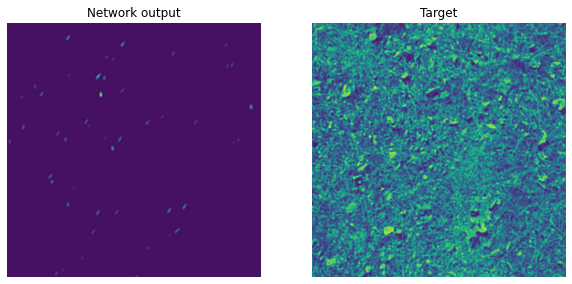

Training epoch 500, took 0.35117077827453613 s

Loss: 0.20209186
RMS deviance: 0.44954628
Learned Min: -0.96736974
Learned RMS: 0.5921446
Learned Max: 0.8931943


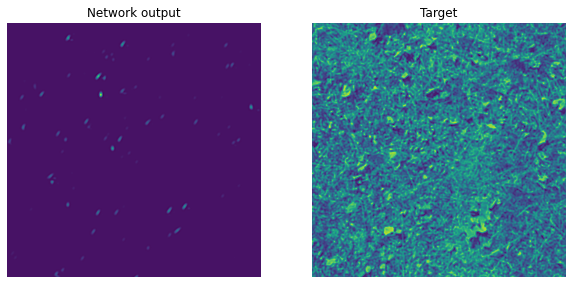

Training epoch 600, took 0.33668041229248047 s

Loss: 0.20135802
RMS deviance: 0.44872934
Learned Min: -0.96046937
Learned RMS: 0.5917651
Learned Max: 0.8918815


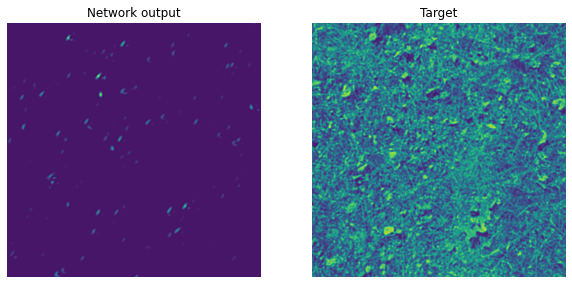

Training epoch 700, took 0.290813684463501 s

Loss: 0.20037332
RMS deviance: 0.4476308
Learned Min: -0.9472828
Learned RMS: 0.59115046
Learned Max: 0.8907944


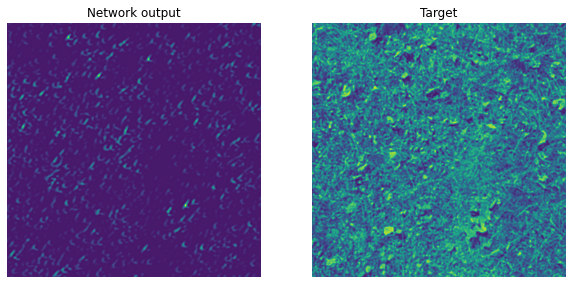

Training epoch 800, took 0.3153409957885742 s

Loss: 0.18437132
RMS deviance: 0.42938483
Learned Min: -0.9417388
Learned RMS: 0.5895184
Learned Max: 0.8898689


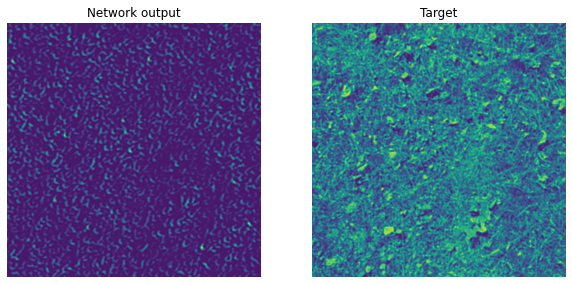

Training epoch 900, took 0.3137168884277344 s

Loss: 0.16331851
RMS deviance: 0.40412685
Learned Min: -0.9419279
Learned RMS: 0.5885804
Learned Max: 0.9230111


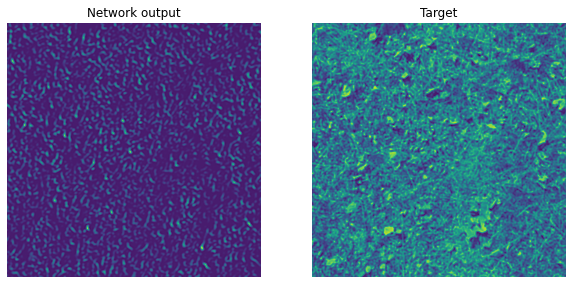

Training epoch 1000, took 0.30394935607910156 s

Loss: 0.15325929
RMS deviance: 0.39148346
Learned Min: -0.942097
Learned RMS: 0.5874708
Learned Max: 0.9086884


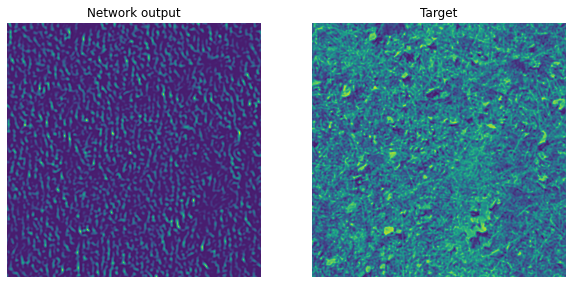

Training epoch 1100, took 0.30313563346862793 s

Loss: 0.13543847
RMS deviance: 0.36801967
Learned Min: -0.9422101
Learned RMS: 0.5872408
Learned Max: 0.9203932


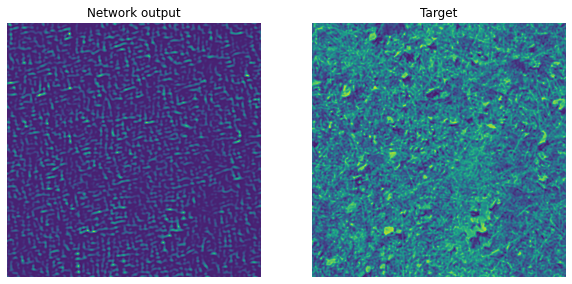

Training epoch 1200, took 0.3215939998626709 s

Loss: 0.1167708
RMS deviance: 0.34171742
Learned Min: -0.94239676
Learned RMS: 0.5891742
Learned Max: 0.95097184


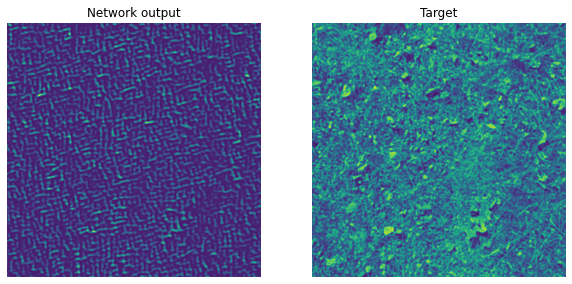

Training epoch 1300, took 0.30249452590942383 s

Loss: 0.10756509
RMS deviance: 0.32797116
Learned Min: -0.9426592
Learned RMS: 0.587747
Learned Max: 0.93348676


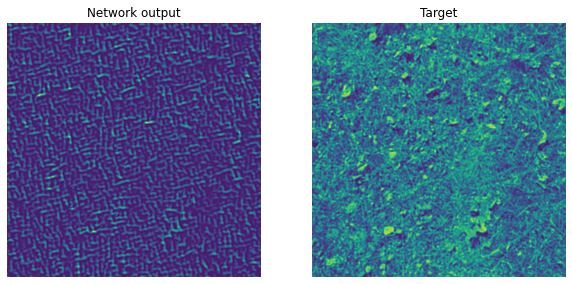

Training epoch 1400, took 0.2989010810852051 s

Loss: 0.09855191
RMS deviance: 0.31392977
Learned Min: -0.94299227
Learned RMS: 0.58689934
Learned Max: 0.9244393


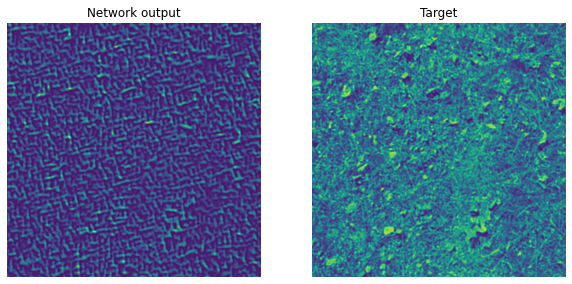

Training epoch 1500, took 0.3002023696899414 s

Loss: 0.08277681
RMS deviance: 0.2877096
Learned Min: -0.94343287
Learned RMS: 0.5866993
Learned Max: 0.92093


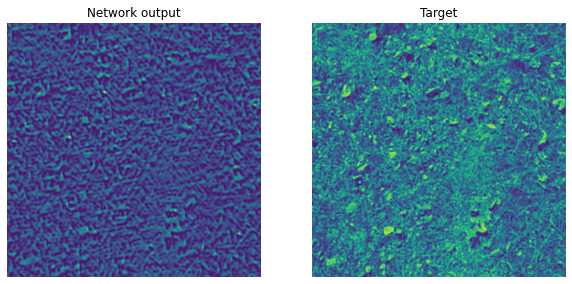

Training epoch 1600, took 0.3280296325683594 s

Loss: 0.0485846
RMS deviance: 0.22041914
Learned Min: -0.9671731
Learned RMS: 0.58693427
Learned Max: 0.92614526


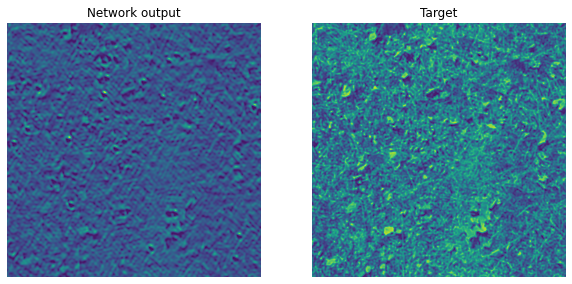

Training epoch 1700, took 0.3590962886810303 s

Loss: 0.02012927
RMS deviance: 0.14187767
Learned Min: -0.9737117
Learned RMS: 0.5842506
Learned Max: 0.91489255


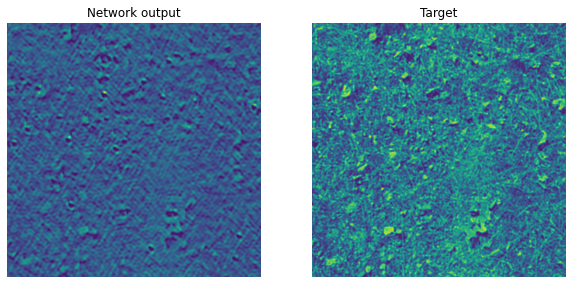

Training epoch 1800, took 0.3207094669342041 s

Loss: 0.016218841
RMS deviance: 0.12735322
Learned Min: -0.9770135
Learned RMS: 0.5828117
Learned Max: 0.9127219


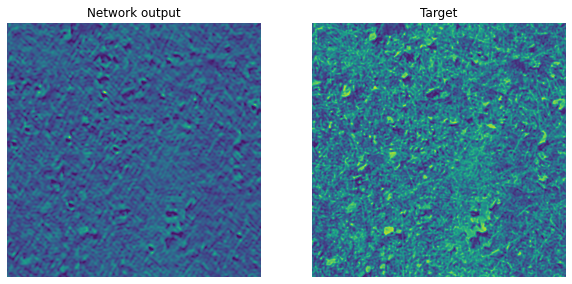

Training epoch 1900, took 0.32077813148498535 s

Loss: 0.014492132
RMS deviance: 0.12038327
Learned Min: -0.98480505
Learned RMS: 0.5821966
Learned Max: 0.91097224


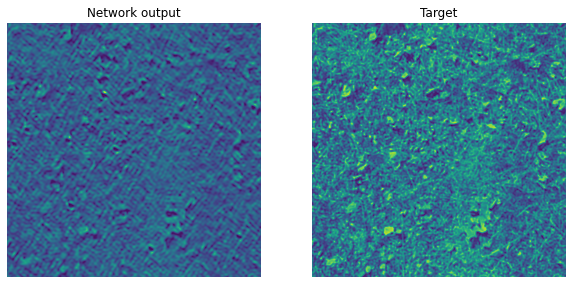

Training epoch 2000, took 0.30484890937805176 s

Loss: 0.013112793
RMS deviance: 0.1145111
Learned Min: -0.9914125
Learned RMS: 0.58159626
Learned Max: 0.9028666


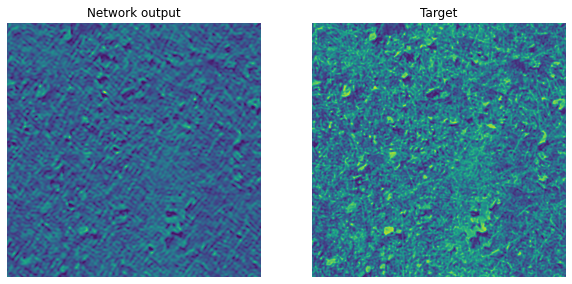

Training epoch 2100, took 0.31341981887817383 s

Loss: 0.011693867
RMS deviance: 0.10813818
Learned Min: -0.9932071
Learned RMS: 0.5809351
Learned Max: 0.8962924


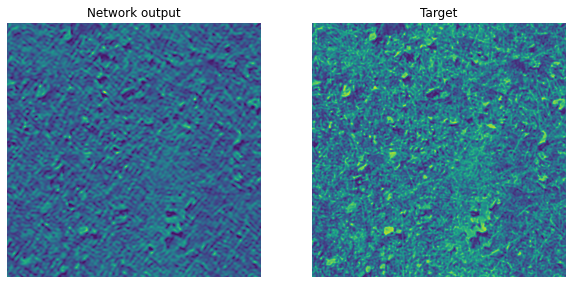

Training epoch 2200, took 0.3062472343444824 s

Loss: 0.010607397
RMS deviance: 0.10299222
Learned Min: -0.99314165
Learned RMS: 0.5805945
Learned Max: 0.89848244


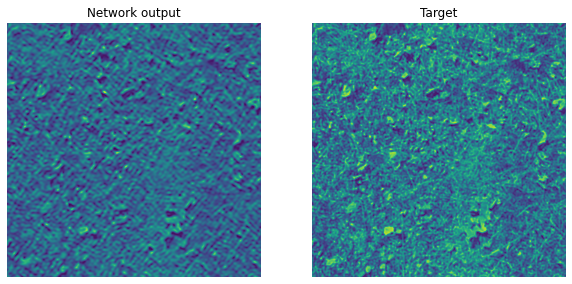

Training epoch 2300, took 0.3164992332458496 s

Loss: 0.009934039
RMS deviance: 0.09966965
Learned Min: -0.99166316
Learned RMS: 0.5804293
Learned Max: 0.9049171


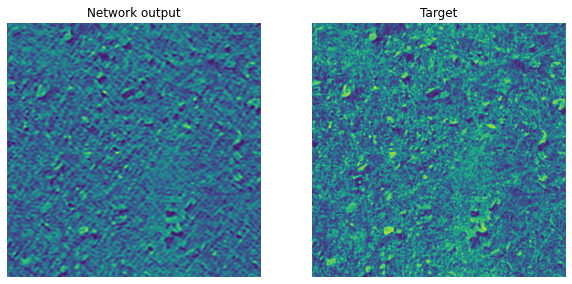

Training epoch 2400, took 0.2983102798461914 s

Loss: 0.009502958
RMS deviance: 0.09748311
Learned Min: -0.9888369
Learned RMS: 0.58029747
Learned Max: 0.9122493


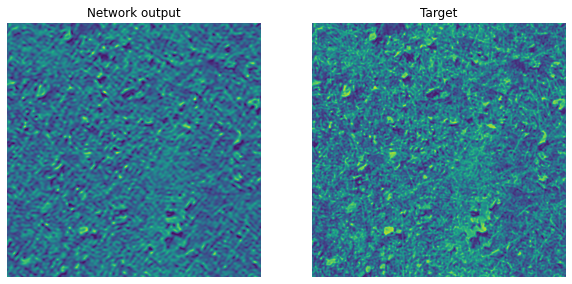

Training epoch 2500, took 0.33480024337768555 s

Loss: 0.009192785
RMS deviance: 0.09587901
Learned Min: -0.9855725
Learned RMS: 0.5801609
Learned Max: 0.91886294


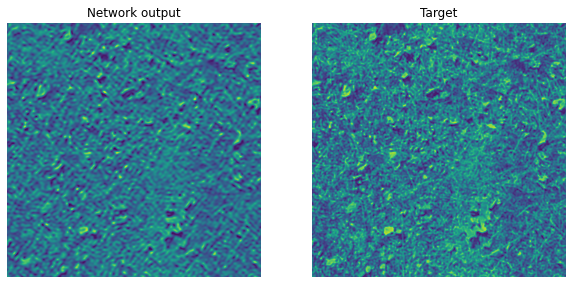

Training epoch 2600, took 0.3404383659362793 s

Loss: 0.008947626
RMS deviance: 0.09459189
Learned Min: -0.9823566
Learned RMS: 0.5800138
Learned Max: 0.9241795


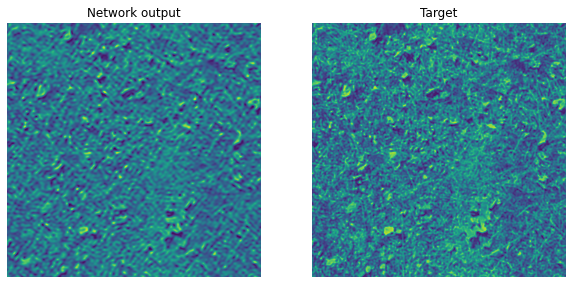

Training epoch 2700, took 0.30084848403930664 s

Loss: 0.008739222
RMS deviance: 0.093483806
Learned Min: -0.9794872
Learned RMS: 0.57985234
Learned Max: 0.9280169


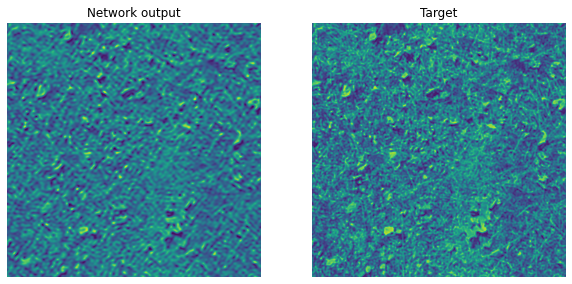

Training epoch 2800, took 0.310258150100708 s

Loss: 0.008556327
RMS deviance: 0.09250042
Learned Min: -0.97693527
Learned RMS: 0.5796763
Learned Max: 0.9306083


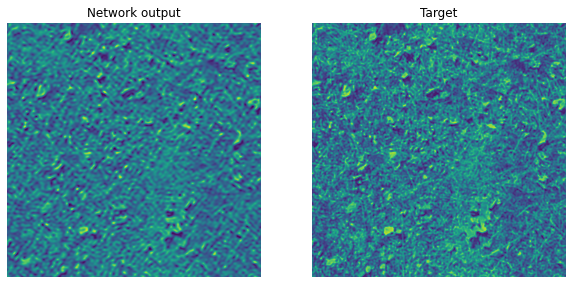

Training epoch 2900, took 0.3230617046356201 s

Loss: 0.008393218
RMS deviance: 0.09161451
Learned Min: -0.97473216
Learned RMS: 0.57948846
Learned Max: 0.9321636


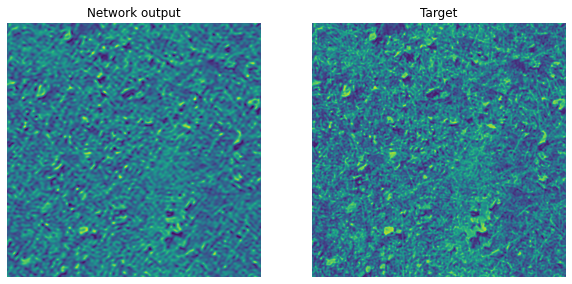

Training epoch 3000, took 0.35544657707214355 s

Loss: 0.0082439445
RMS deviance: 0.09079617
Learned Min: -0.97297376
Learned RMS: 0.57930046
Learned Max: 0.9329146


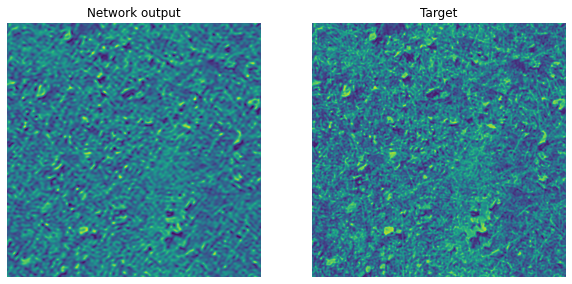

Training epoch 3100, took 0.34485912322998047 s

Loss: 0.008107842
RMS deviance: 0.09004355
Learned Min: -0.9715132
Learned RMS: 0.5791148
Learned Max: 0.93308616


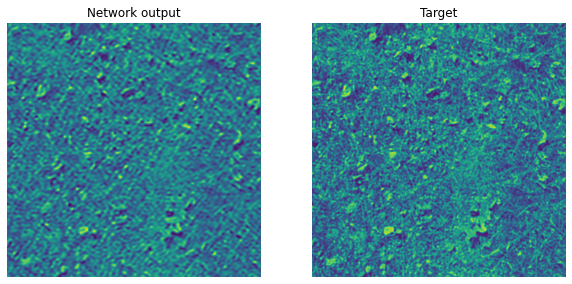

Training epoch 3200, took 0.3807351589202881 s

Loss: 0.007981579
RMS deviance: 0.08933968
Learned Min: -0.9701779
Learned RMS: 0.5789211
Learned Max: 0.9327333


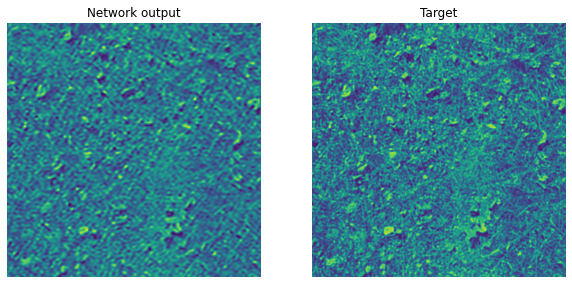

Training epoch 3300, took 0.37410759925842285 s

Loss: 0.007862681
RMS deviance: 0.08867176
Learned Min: -0.96891516
Learned RMS: 0.5787227
Learned Max: 0.9320532


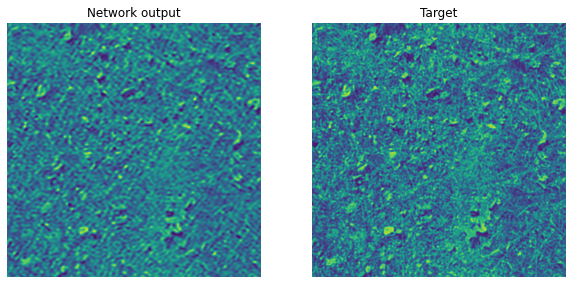

Training epoch 3400, took 0.34923410415649414 s

Loss: 0.007753016
RMS deviance: 0.088051215
Learned Min: -0.96797085
Learned RMS: 0.5785338
Learned Max: 0.9310142


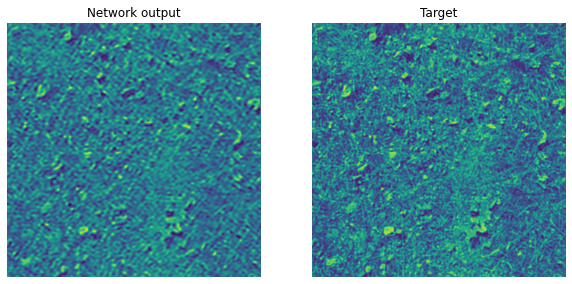

Training epoch 3500, took 0.3456852436065674 s

Loss: 0.0076531493
RMS deviance: 0.08748228
Learned Min: -0.96721494
Learned RMS: 0.5783579
Learned Max: 0.92986715


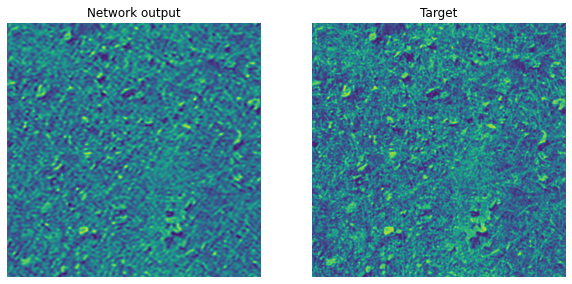

Training epoch 3600, took 0.3320314884185791 s

Loss: 0.007558656
RMS deviance: 0.086940534
Learned Min: -0.9665415
Learned RMS: 0.57818776
Learned Max: 0.9286451


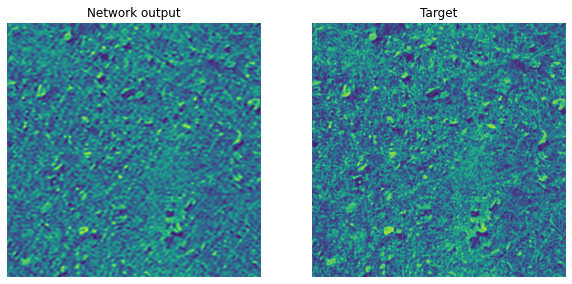

Training epoch 3700, took 0.33449721336364746 s

Loss: 0.0074707014
RMS deviance: 0.08643322
Learned Min: -0.965889
Learned RMS: 0.57801753
Learned Max: 0.9273596


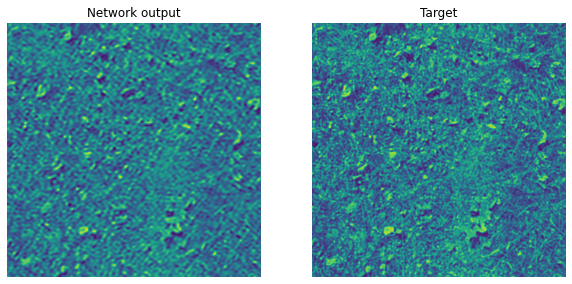

Training epoch 3800, took 0.3563992977142334 s

Loss: 0.0073902598
RMS deviance: 0.08596662
Learned Min: -0.9653128
Learned RMS: 0.57785255
Learned Max: 0.9260105


In [ ]:
EPOCHS = 10000
fit(EPOCHS)

In [14]:
print("learned_conv_1 weights and biases:\n")
print(model.get_layer('learned_conv_1').get_weights())
print("\nlearned_conv_2 weights and biases:\n")
print(model.get_layer('learned_conv_2').get_weights())

learned_conv_1 weights and biases:

[array([[[[-0.94973624, -0.9030416 ]],

        [[ 0.48296693,  0.40872353]],

        [[ 0.08086881, -0.4688723 ]],

        [[ 0.15249838,  0.22300981]]],


       [[[ 0.60749876,  0.1276281 ]],

        [[-0.3970263 , -0.59688437]],

        [[-0.54838204,  0.49983656]],

        [[ 0.49287933,  0.25426695]]],


       [[[ 0.13116203,  0.0097908 ]],

        [[ 1.1091605 , -0.78350705]],

        [[-0.80248576, -0.30360037]],

        [[-0.5613746 ,  0.35239384]]],


       [[[ 0.80437833,  0.79768115]],

        [[ 0.17592831,  0.09591913]],

        [[ 0.29907745, -1.0233442 ]],

        [[ 0.69078827,  0.96165335]]]], dtype=float32), array([-0.08318789,  0.07589049], dtype=float32)]

learned_conv_2 weights and biases:

[array([[[[ 0.24661964,  0.06856785],
         [-0.31802264, -0.9636979 ]],

        [[-0.18052517,  0.7896716 ],
         [-0.8330658 , -0.00529913]],

        [[ 1.0381749 , -0.6085476 ],
         [ 0.9913018 ,  0.72856635]],



In [12]:
def load_ckpt(latest = True, number = 1):
  if latest:
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
  else:
    checkpoint.restore('training_checkpoints_downup/ckpt-' + str(number))

# load_ckpt(False, 46)